# No 2.1: Visualisasi Waveform dan Spektogram Audio


## 1. Import Library yang Diperlukan

In [18]:
import os
import librosa
import librosa.display
import matplotlib.pyplot as plt
import IPython.display as ipd
import numpy as np
import warnings
warnings.filterwarnings('ignore')

print("Library berhasil diimport!")

Library berhasil diimport!


## 2. Load Audio 

In [19]:
# Load langsung dari file WAV 
loaded_path = os.path.join(os.getcwd(), 'fadil.wav')

try:
    if not os.path.exists(loaded_path):
        raise FileNotFoundError("Tidak ditemukan 'fadil.wav' di folder kerja saat ini.")

    # Load WAV dengan sample rate asli dan pertahankan channel
    y, sr = librosa.load(loaded_path, sr=None, mono=False)
    source_info = f"✅ Berhasil memuat WAV: {os.path.basename(loaded_path)}"
except Exception:
    # Fallback: sample bawaan librosa
    try:
        y, sr = librosa.load(librosa.ex('trumpet'), sr=None)
        source_info = "✅ Menggunakan sample audio bawaan librosa (trumpet)"
        loaded_path = None
    except Exception:
        # Fallback terakhir: sinyal sinus
        sr = 22050
        duration = 3.0
        freq = 440
        t = np.linspace(0, duration, int(sr * duration), endpoint=False)
        y = 0.5 * np.sin(2 * np.pi * freq * t).astype(np.float32)
        source_info = f"✅ Menggunakan sinyal sinus buatan ({freq} Hz)"
        loaded_path = None

# Opsional: konversi ke mono untuk analisis frekuensi yang konsisten
if hasattr(y, 'ndim') and y.ndim > 1:
    y_mono = np.mean(y, axis=0).astype(np.float32)
    source_info += " - Dikonversi ke mono untuk analisis"
else:
    y_mono = y.astype(np.float32, copy=False)

print(source_info)
ipd.display(ipd.Audio(y, rate=sr))

✅ Berhasil memuat WAV: fadil.wav - Dikonversi ke mono untuk analisis


## 3. Tampilkan Properti Audio

In [3]:
# Tampilkan properti audio yang telah dimuat
from typing import Tuple

def get_channels_and_shape(arr: np.ndarray) -> Tuple[int, tuple]:
    if arr.ndim == 1:
        return 1, arr.shape
    else:
        return arr.shape[0], arr.shape

channels, shape = get_channels_and_shape(y if hasattr(y, 'ndim') else np.asarray(y))

duration = librosa.get_duration(y=y_mono, sr=sr)
print(source_info)
print(f"Sample Rate: {sr} Hz")
print(f"Durasi: {duration:.2f} detik")
print(f"Channels (sebelum mono): {channels}")
print(f"Total Samples per channel: {shape[-1]}")
print(f"Array shape: {shape}")

✅ Berhasil memuat WAV: fadil.wav - Dikonversi ke mono untuk analisis
Sample Rate: 48000 Hz
Durasi: 35.27 detik
Channels (sebelum mono): 2
Total Samples per channel: 1693184
Array shape: (2, 1693184)


## 4. Visualisasi Waveform

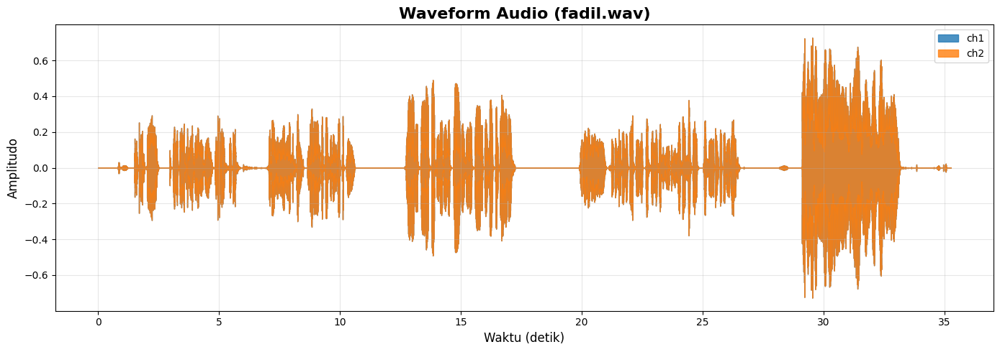

In [4]:
# Visualisasi waveform
plt.figure(figsize=(14, 5))

# Jika multi-channel tersedia, tampilkan semua; jika tidak, gunakan y_mono
if hasattr(y, 'ndim') and y.ndim > 1:
    for ch in range(y.shape[0]):
        librosa.display.waveshow(y[ch], sr=sr, alpha=0.8, label=f'ch{ch+1}')
    plt.legend(loc='upper right')
else:
    librosa.display.waveshow(y_mono, sr=sr, alpha=0.9, label='mono')

plt.title(f'Waveform Audio ({os.path.basename(loaded_path) if "loaded_path" in globals() and loaded_path else "sample"})', fontsize=16, fontweight='bold')
plt.xlabel('Waktu (detik)', fontsize=12)
plt.ylabel('Amplitudo', fontsize=12)
plt.grid(True, alpha=0.3)
plt.tight_layout()
plt.show()

## Analisis

pada detik ke 0-5 suara yang dihasilkan normal, pada detik 7-12 suara yang dihasilkan dari segi keras lemahnya suara sama seperti 0-5, pada 13-18 suara yang dihasilkan lebih keras, 20-25 lebih pelan dari 0-18, pada 28-33 suara yang dihasilkan tertinggi

## 5. Visualisasi Spektogram (STFT)

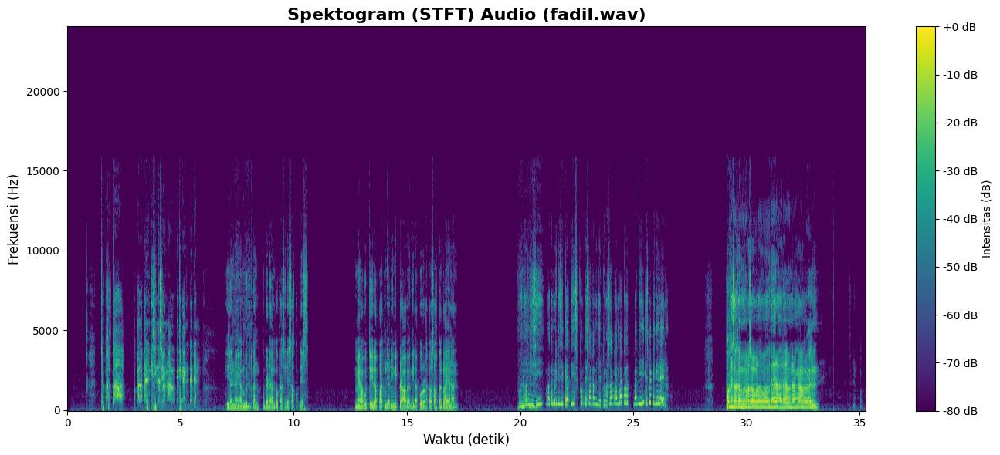

In [5]:
# STFT pada sinyal mono (y_mono) mengikuti gaya Week 1 (n_fft=512, hop_length=128)
n_fft = 512
hop_length = 128
window = 'hann'

D = librosa.stft(y_mono, n_fft=n_fft, hop_length=hop_length, window=window)
S_db = librosa.amplitude_to_db(np.abs(D), ref=np.max)

plt.figure(figsize=(14, 6))
librosa.display.specshow(S_db, sr=sr, x_axis='time', y_axis='hz', cmap='viridis', hop_length=hop_length)
plt.colorbar(format='%+2.0f dB', label='Intensitas (dB)')
plt.title(f'Spektogram (STFT) Audio ({os.path.basename(loaded_path) if "loaded_path" in globals() and loaded_path else "sample"})', fontsize=16, fontweight='bold')
plt.xlabel('Waktu (detik)', fontsize=12)
plt.ylabel('Frekuensi (Hz)', fontsize=12)
plt.tight_layout()
plt.show()

## Analisis

pada detik 0-5 suara menghasilkan frequency rendah dan tinggi pada detik 5-10 suara menghasilkan frekuensi rendah pada detik 13-18 suara menghasilkan frekuensi rendah pada detik 20-25 suara menghasilkan frekuensi yang agak naik dari suara sebelumnya pada detik 28-33 suara menghasilkan frekuensi rendah tapi agak naik sedikit dengan intens yang tinggi

# No 2.2: Noise Filtering dengan Equalization (LP/HP/BP)

Tujuan: Memuat `noise.wav`, menerapkan filter low-pass, high-pass, dan band-pass pada beberapa cutoff (500, 1000, 2000 Hz), lalu membandingkan spektrogram hasilnya.

In [20]:
# 1) Load noise.wav
try:
    y, sr = librosa.load('noise.wav', sr=None)
    src_label = 'noise.wav'
except Exception:
    y, sr = librosa.load(librosa.ex('trumpet'), sr=None)
    src_label = 'librosa.trumpet (fallback)'

if hasattr(y, 'ndim') and y.ndim > 1:
    y = np.mean(y, axis=0)

print(f'Source: {src_label}, sr={sr}, duration={len(y)/sr:.2f}s')
print(f"\n🎧 Memutar sumber audio: {src_label}")
ipd.display(ipd.Audio(y, rate=sr))

Source: noise.wav, sr=48000, duration=9.83s

🎧 Memutar sumber audio: noise.wav


## Desain Filter FIR (Windowed-Sinc)

Kita gunakan FIR berbasis windowed-sinc agar tetap di dalam batasan library (NumPy, Librosa, Matplotlib) tanpa SciPy.

In [7]:
def hann_window(M):
    return 0.5 - 0.5 * np.cos(2*np.pi*np.arange(M)/(M-1))

def sinc(x):
    # normalized sinc sin(pi x)/(pi x)
    x = np.asarray(x)
    out = np.ones_like(x)
    nz = x != 0
    out[nz] = np.sin(np.pi*x[nz])/(np.pi*x[nz])
    return out

def fir_lowpass(fc, fs, M):
    # fc: cutoff Hz, fs: sample rate, M: taps (odd recommended)
    fc_norm = fc / (fs/2)  # normalized to Nyquist
    n = np.arange(M)
    m = n - (M-1)/2
    h = 2*fc_norm * sinc(2*fc_norm*m)
    w = hann_window(M)
    h = h * w
    h = h / np.sum(h)
    return h

def fir_highpass(fc, fs, M):
    # spectral inversion of lowpass
    lp = fir_lowpass(fc, fs, M)
    hp = -lp
    hp[(M-1)//2] += 1
    return hp

def fir_bandpass(f1, f2, fs, M):
    # difference of two lowpass
    lp2 = fir_lowpass(f2, fs, M)
    lp1 = fir_lowpass(f1, fs, M)
    bp = lp2 - lp1
    # normalize passband energy roughly
    bp = bp / np.sum(np.abs(bp))
    return bp

def apply_fir(x, h):
    return np.convolve(x, h, mode='same')

## Eksperimen Cutoff: 500 Hz, 1000 Hz, 2000 Hz

In [8]:
cutoffs = [500, 1000, 2000]
M = 257  # jumlah tap FIR (ganjil)

results = {}
for fc in cutoffs:
    lp = fir_lowpass(fc, sr, M)
    hp = fir_highpass(fc, sr, M)
    # Untuk band-pass, gunakan dua contoh band: [fc, 2*fc] jika masih < Nyquist
    f2 = min(2*fc, sr/2 * 0.95)
    if f2 <= fc:
        f2 = fc * 1.5
    bp = fir_bandpass(fc, f2, sr, M)

    y_lp = apply_fir(y, lp)
    y_hp = apply_fir(y, hp)
    y_bp = apply_fir(y, bp)

    results[fc] = {'lp': y_lp, 'hp': y_hp, 'bp': y_bp, 'f2': f2}

print('Filtering selesai untuk cutoff:', cutoffs)

Filtering selesai untuk cutoff: [500, 1000, 2000]
 [500, 1000, 2000]


## Fungsi Plotting

In [9]:
def plot_wave(y_sig, sr, title):
    plt.figure(figsize=(14, 3))
    librosa.display.waveshow(y_sig, sr=sr, color='tab:blue')
    plt.title(title + ' - Waveform', fontweight='bold')
    plt.xlabel('Waktu (detik)')
    plt.ylabel('Amplitudo')
    plt.grid(True, alpha=0.3)
    plt.tight_layout()

def plot_spec(y_sig, sr, ax, title):
    D = librosa.stft(y_sig, n_fft=1024, hop_length=256, win_length=1024)
    S_db = librosa.amplitude_to_db(np.abs(D), ref=np.max)
    img = librosa.display.specshow(S_db, sr=sr, hop_length=256, x_axis='time', y_axis='hz', ax=ax)
    ax.set_title(title + ' - Spektrogram (STFT)', fontweight='bold')
    plt.colorbar(img, ax=ax, format="%+2.0f dB")

## Visualisasi Original dan Hasil Filter

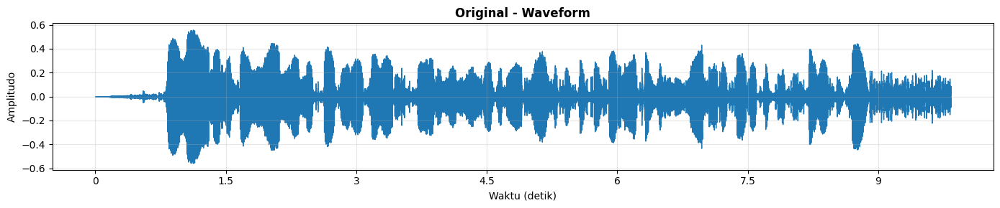

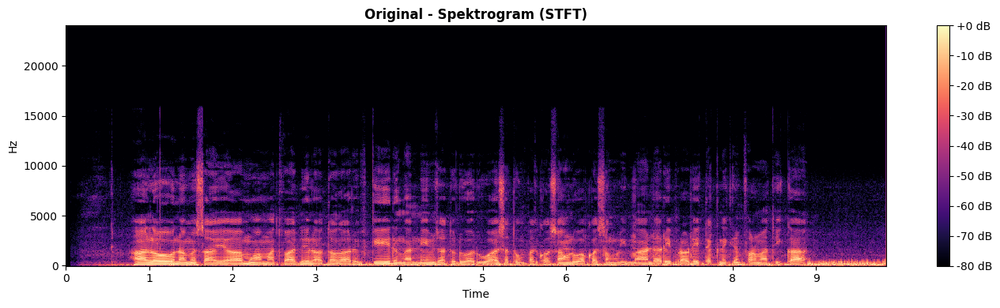

In [10]:
# Original
y_orig = y
plot_wave(y_orig, sr, 'Original')
plt.figure(figsize=(14, 4))
plot_spec(y_orig, sr, plt.gca(), 'Original')
plt.tight_layout()

### Low-pass Filter Results

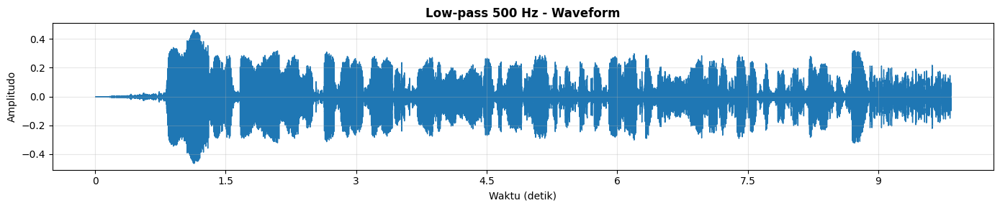

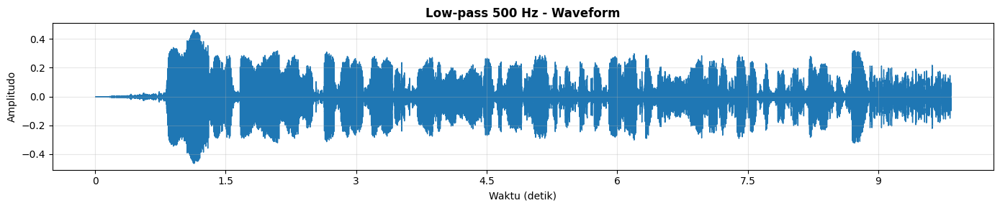

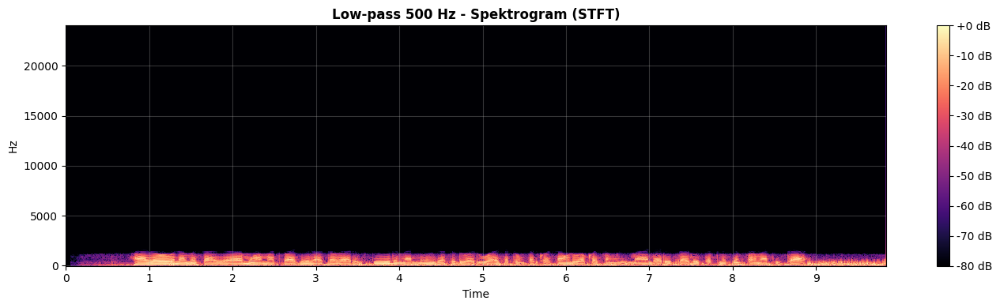

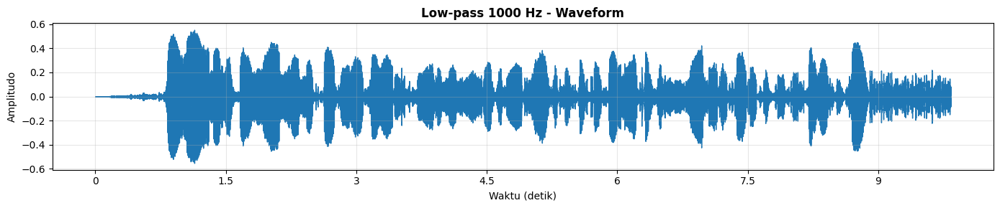

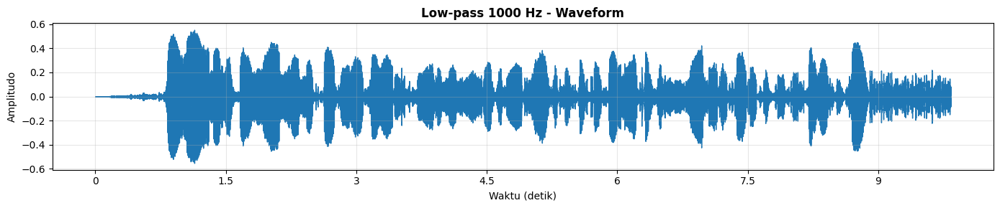

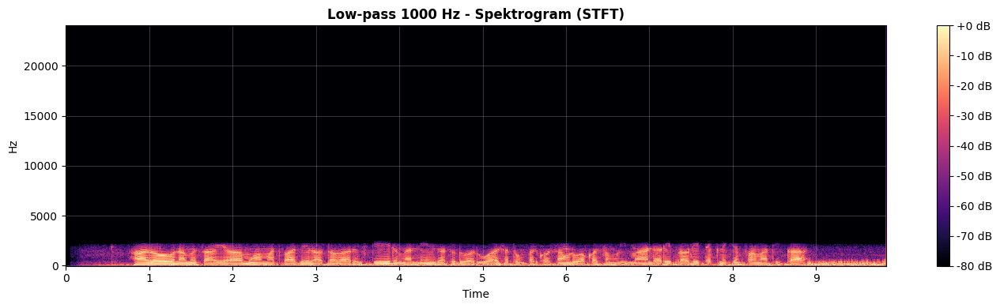

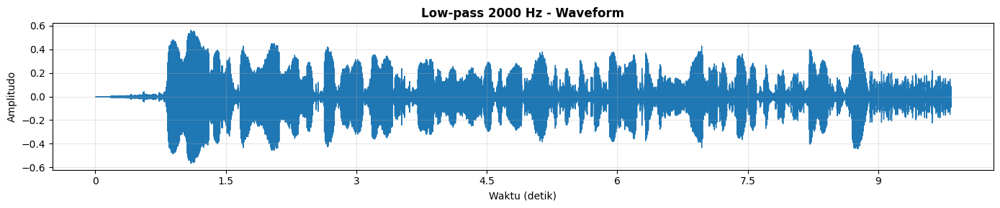

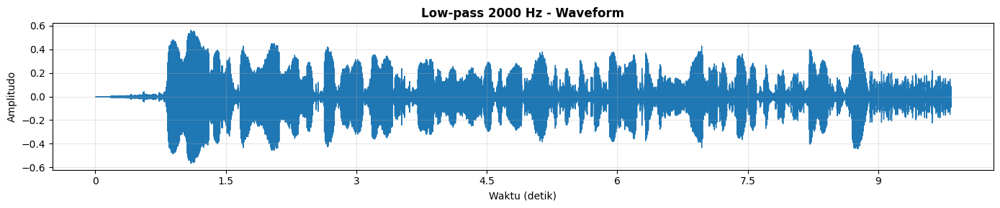

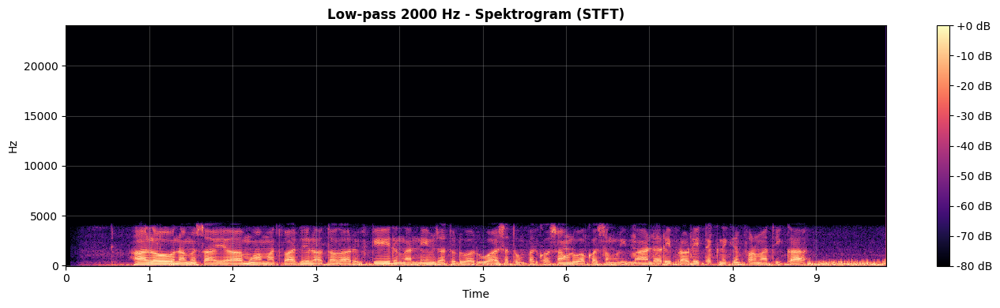

In [21]:
for fc in cutoffs:
    y_lp = results[fc]['lp']
    ipd.display(ipd.Audio(y_lp, rate=sr))
    plot_wave(y_lp, sr, f'Low-pass {fc} Hz')
    plot_wave(y_lp, sr, f'Low-pass {fc} Hz')
    plt.figure(figsize=(14, 4))
    plot_spec(y_lp, sr, plt.gca(), f'Low-pass {fc} Hz')
    plt.tight_layout()

### High-pass Filter Results

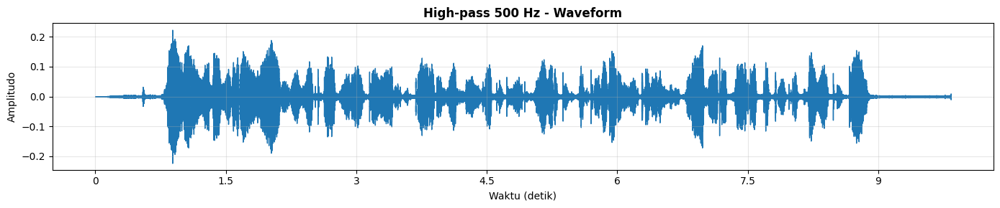

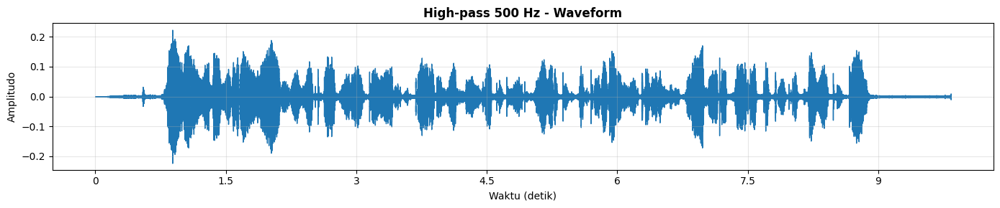

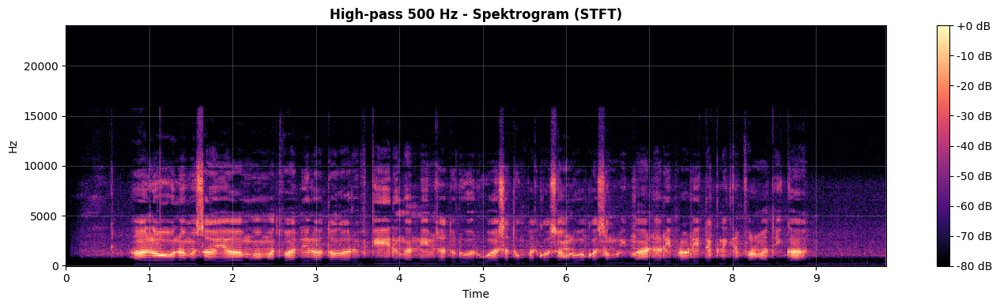

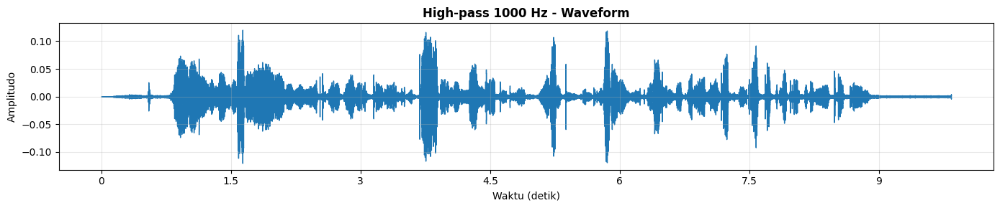

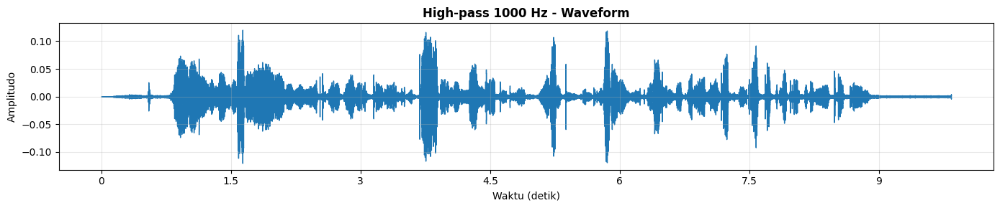

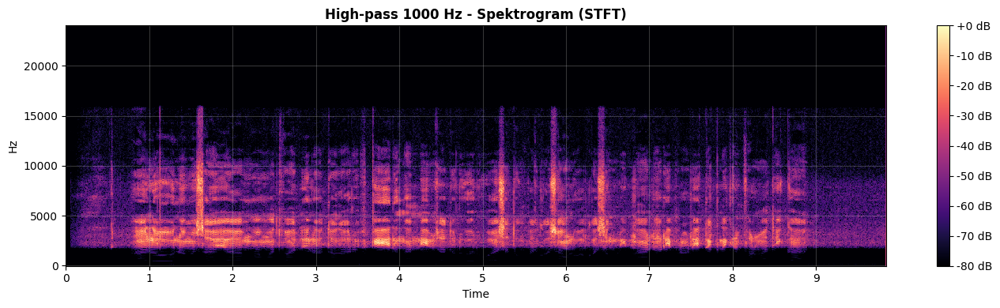

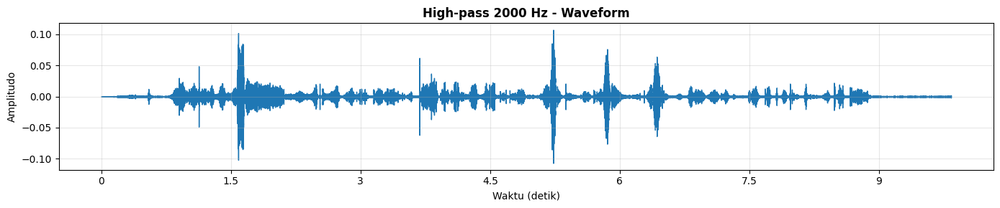

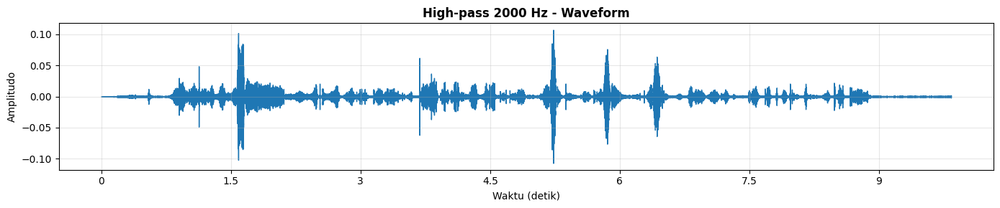

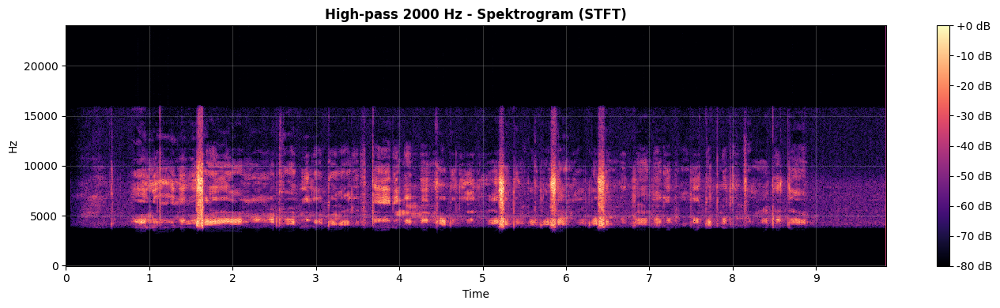

In [23]:
for fc in cutoffs:
    y_hp = results[fc]['hp']
    ipd.display(ipd.Audio(y_hp, rate=sr))
    plot_wave(y_hp, sr, f'High-pass {fc} Hz')
    plot_wave(y_hp, sr, f'High-pass {fc} Hz')
    plt.figure(figsize=(14, 4))
    plot_spec(y_hp, sr, plt.gca(), f'High-pass {fc} Hz')
    plt.tight_layout()

### Band-pass Filter Results


🎧 Memutar hasil Band-pass 500-1000 Hz



🎧 Memutar hasil Band-pass 1000-2000 Hz



🎧 Memutar hasil Band-pass 2000-4000 Hz


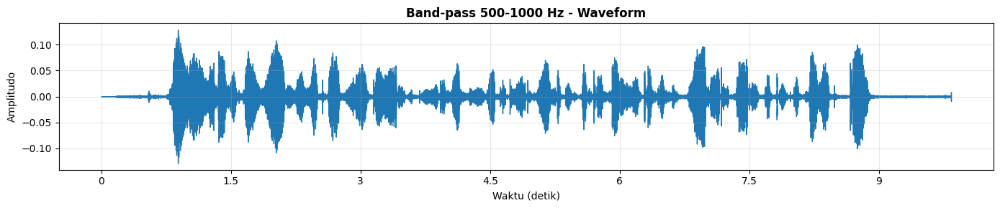

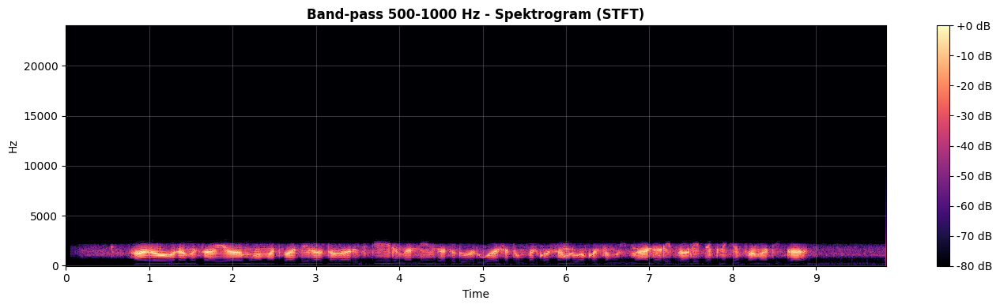

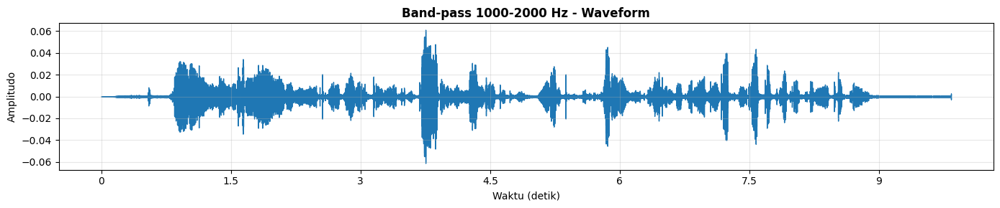

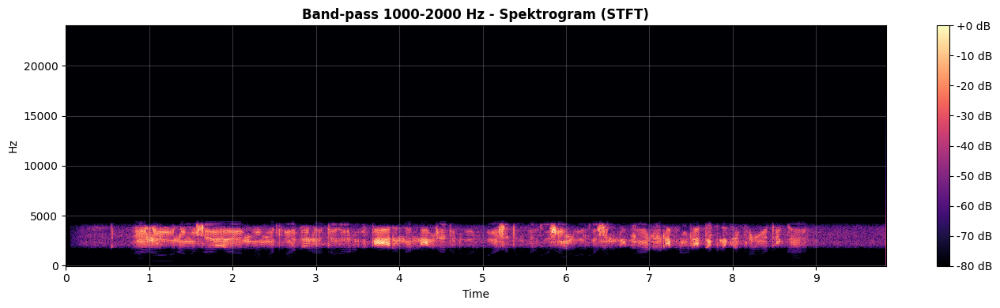

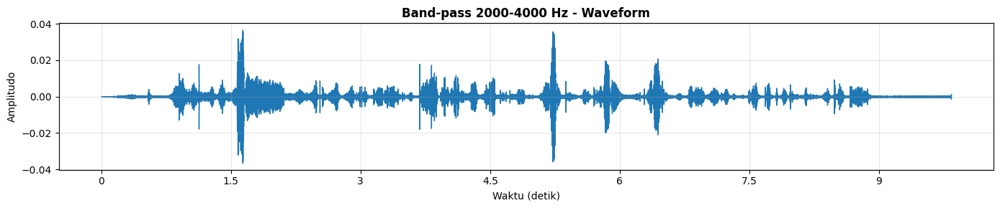

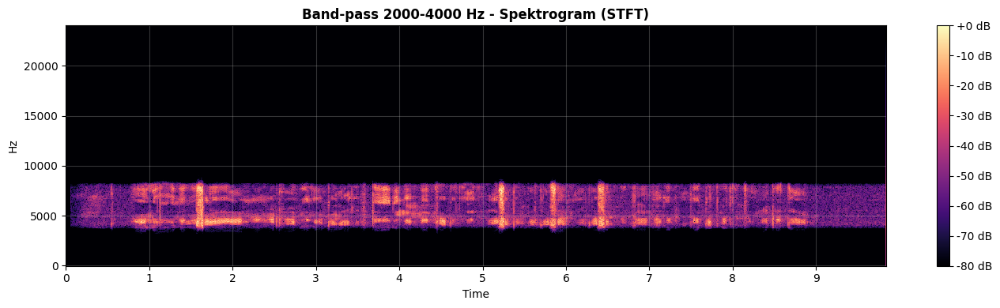

In [22]:
for fc in cutoffs:
    y_bp = results[fc]['bp']
    f2 = int(results[fc]['f2'])
    print(f"\n🎧 Memutar hasil Band-pass {fc}-{f2} Hz")
    ipd.display(ipd.Audio(y_bp, rate=sr))
    plot_wave(y_bp, sr, f'Band-pass {fc}-{f2} Hz')
    plt.figure(figsize=(14, 4))
    plot_spec(y_bp, sr, plt.gca(), f'Band-pass {fc}-{f2} Hz')
    plt.tight_layout()

# Bagian 3: Chipmunk Pitch Shifting

Notebook ini melakukan pitch shifting suara untuk membuat efek chipmunk (+7 dan +12 semitone), disertai visualisasi waveform dan spektrogram.

## 1. Import Library & Setup

In [1]:
plt.style.use('default')
plt.rcParams['figure.facecolor'] = 'white'
plt.rcParams['axes.grid'] = True
plt.rcParams['grid.alpha'] = 0.3

print("Librosa:", librosa.__version__)

NameError: name 'plt' is not defined

## 2. Plot Functions for Visualization

In [ ]:
def plot_wave_spec(y_sig, sr, title_prefix):
    fig, axes = plt.subplots(2, 1, figsize=(14, 8))
    # Waveform
    librosa.display.waveshow(y_sig, sr=sr, ax=axes[0], color='tab:blue')
    axes[0].set_title(f'{title_prefix} - Waveform', fontweight='bold')
    axes[0].set_xlabel('Waktu (detik)')
    axes[0].set_ylabel('Amplitudo')
    axes[0].grid(True, alpha=0.3)
    # Spectrogram (Week1 style)
    n_fft, hop = 512, 128
    D = librosa.stft(y_sig, n_fft=n_fft, hop_length=hop, window='hann')
    S_db = librosa.amplitude_to_db(np.abs(D), ref=np.max)
    img = librosa.display.specshow(S_db, sr=sr, x_axis='time', y_axis='hz', hop_length=hop, cmap='viridis', ax=axes[1])
    axes[1].set_title(f'{title_prefix} - Spektrogram (STFT)', fontweight='bold')
    axes[1].set_xlabel('Waktu (detik)')
    axes[1].set_ylabel('Frekuensi (Hz)')
    plt.colorbar(img, ax=axes[1], format='%+2.0f dB')
    plt.tight_layout()

## 3. Pitch Shifting: +7 dan +12 Semitone

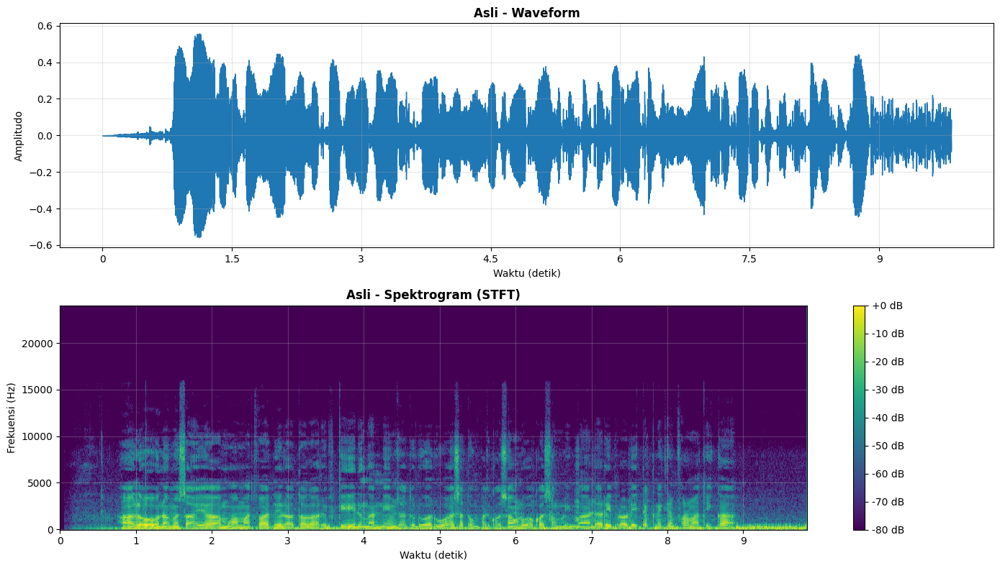

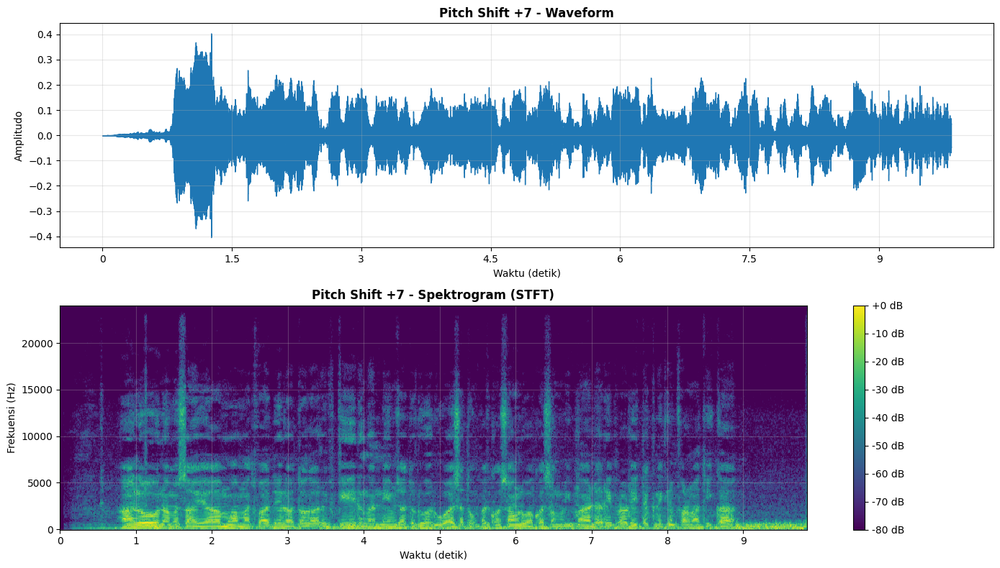

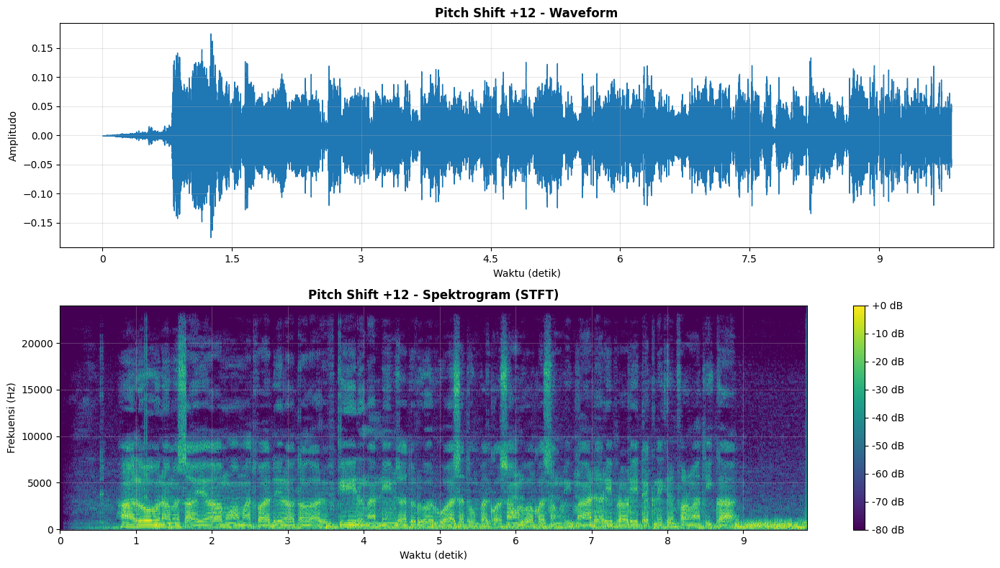

In [ ]:
# Parameter
semitones_1 = 7
semitones_2 = 12

# Librosa pitch shift (phase vocoder)
y_ps7 = librosa.effects.pitch_shift(y, sr=sr, n_steps=semitones_1)
y_ps12 = librosa.effects.pitch_shift(y, sr=sr, n_steps=semitones_2)

# Visualisasi
plot_wave_spec(y, sr, 'Asli')
plot_wave_spec(y_ps7, sr, f'Pitch Shift +{semitones_1}')
plot_wave_spec(y_ps12, sr, f'Pitch Shift +{semitones_2}')

# Catatan: Pemutaran audio langsung dihilangkan untuk mematuhi batasan library (hanya numpy/librosa/matplotlib).

Noise yang muncul adalah suara angin dari kipas angin. Filter yang paling efektif untuk noise dari kipas angin adalah high pass dengan nilai cutoff 1000hz. Kualitas suara cukup buruk karena suara yang dihasilkan juga berada di frekuensi rendah sehingga terfilter juga.

## Lampiran


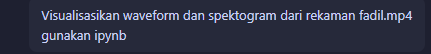

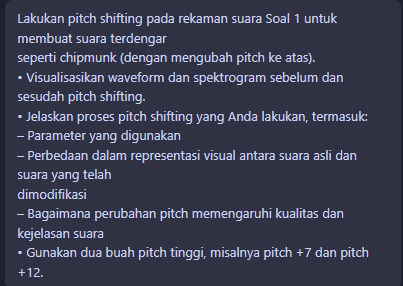

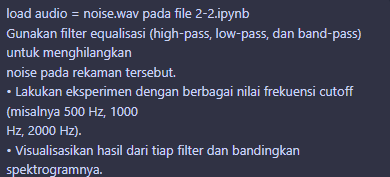

In [2]:
from IPython.display import Image, display
print("## Lampiran")

display(Image(filename="Screenshot 2025-10-17 230152.png"))
display(Image(filename="Screenshot 2025-10-17 230216.png"))
display(Image(filename="image.png"))